# Autoencoder EC Methodology (Keras)

In [3]:
import pandas as pd
import numpy as np
import os
import seaborn as sns

from datetime import datetime 
#from tqdm import tqdm 

from sklearn.metrics import roc_auc_score as auc 
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import (confusion_matrix, precision_recall_curve, auc,
                             roc_curve, recall_score, classification_report, f1_score,
                             precision_recall_fscore_support)
from sklearn.model_selection import train_test_split

import matplotlib.pyplot as plt
import matplotlib.gridspec as gridspec
%matplotlib inline

import plotly 
#plotly.tools.set_credentials_file(username='gomesc', api_key='8Vj78T6lGLdM0TdfHYGh')
#plotly.tools.set_config_file(world_readable=False,sharing='private')

from plotly.offline import download_plotlyjs, init_notebook_mode, plot, iplot
init_notebook_mode(connected=True)

#import plotly.plotly as py
import plotly.graph_objs as go
import plotly.figure_factory as ff

#Keras Packages  
from keras.layers import Input, Dense, Lambda 
from keras import backend as K 
from keras import objectives 
from scipy.stats import norm 
from keras.utils import plot_model
from keras.callbacks import ModelCheckpoint, TensorBoard
from keras import regularizers
from keras.models import Model, load_model

/home/gomesc/anaconda3/lib/python3.5/site-packages/h5py/__init__.py:36: FutureWarning:

Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.

Using TensorFlow backend.


## Importing the Data 

In [4]:
import os.path 

if os.path.exists("df.csv")==True:
    print("File exist")
    df= pd.read_csv('df.csv')
else:
    print("File does not exist..... Creating file now ")
    
    print("reading source files....")
    df_id_train = pd.read_csv("ieee_data/train_identity.csv")
    df_tran_train = pd.read_csv("ieee_data/train_transaction.csv")
    df_id_test = pd.read_csv("ieee_data/test_identity.csv")
    df_tran_test = pd.read_csv("ieee_data/test_transaction.csv")
    
    print("Creating files...")
    df_train = pd.merge(df_tran_train,df_id_train, on='TransactionID' ,how='left')
    list = ['TransactionID','DeviceInfo']
    df = df_train.drop(list, axis=1)

    # encoding strings
    obj_df = df.select_dtypes(include=['object']).copy()
    int_df = df.select_dtypes(include=['int64']).copy()
    float_df = df.select_dtypes(include=['float64']).copy()

    for column in obj_df.head(0):
        obj_df[column] = obj_df[column].astype('category')
        obj_df[column] = obj_df[column].cat.codes

    df = pd.concat([obj_df,int_df,float_df],axis=1, sort=False) 
    df.fillna(value=-1,inplace=True)
    df.to_csv (r'df.csv', index = None, header=True)

File exist


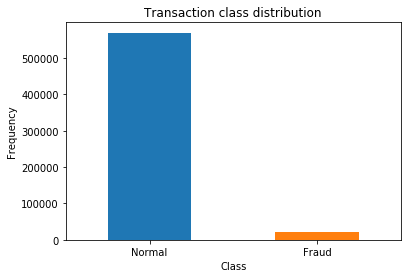

In [5]:
#plot of the Class counts 
LABELS = ["Normal", "Fraud"]
count_classes = pd.value_counts(df['isFraud'], sort = True)
count_classes.plot(kind = 'bar', rot=0)
plt.title("Transaction class distribution")
plt.xticks(range(2), LABELS)
plt.xlabel("Class")
plt.ylabel("Frequency");

In [6]:
#print(df.head())
print("Are there any NaN values in the data frame: {}".format(df.isna().values.any()))
print("Are there any Null values in the data frame: {}".format(df.isnull().values.any()))

Are there any NaN values in the data frame: False
Are there any Null values in the data frame: False


## Data Split 

In [7]:
train_x, test_x = train_test_split(df, test_size=0.2, random_state = 45)
train_x = train_x[train_x.isFraud == 0]
train_x = train_x.drop(['isFraud'], axis=1)

test_y = test_x['isFraud']
test_x = test_x.drop(['isFraud'], axis=1)

train_x = train_x.values
test_x = test_x.values

print(train_x.shape)
print(test_x.shape)
print(df.shape)

(455949, 431)
(118108, 431)
(590540, 432)


In [8]:
#print("Total train examples: {}, total fraud cases: {}, equal to {:.5f} of total cases. ".format(train_x.shape[0], np.sum(train_y), np.sum(train_y)/train_x.shape[0]))

In [9]:
print("Total test examples: {}, total fraud cases: {}, equal to {:.5f} of total cases. ".format(test_x.shape[0], np.sum(test_y), np.sum(test_y)/test_y.shape[0]))

Total test examples: 118108, total fraud cases: 4180, equal to 0.03539 of total cases. 


## Normalising the Data 

In [10]:
need_Normalizing = "True" # no Normalizing needed for this since allready PCA form 
activation_type = "sig"

if need_Normalizing=="True":
    if activation_type == "sig":
        cols_max = []
        cols_min = []
        for c in range(train_x.shape[1]):
            cols_max.append(train_x[:,c].max())
            cols_min.append(train_x[:,c].min())
            train_x[:, c] = (train_x[:, c] - cols_min[-1]) / (cols_max[-1] - cols_min[-1])
            test_x[:, c] =  (test_x[:, c] - cols_min[-1]) / (cols_max[-1] - cols_min[-1])
        print("sigmoid type normalisation done")

    else:
        cols_mean = []
        cols_std = []
        for c in range(train_x.shape[1]):
            cols_mean.append(train_x[:,c].mean())
            cols_std.append(train_x[:,c].std())
            train_x[:, c] = (train_x[:, c] - cols_mean[-1]) / cols_std[-1]
            test_x[:, c] =  (test_x[:, c] - cols_mean[-1]) / cols_std[-1]
        print("tanh type normalisation done")
else:
    print("No Normalizing done")

sigmoid type normalisation done


In [11]:
train_x[0:5,:]

array([[1.        , 0.75      , 0.75      , ..., 0.        , 0.        ,
        0.        ],
       [1.        , 1.        , 0.75      , ..., 0.        , 0.        ,
        0.        ],
       [0.5       , 0.75      , 0.75      , ..., 0.        , 0.        ,
        0.75757576],
       [1.        , 1.        , 0.75      , ..., 0.        , 0.        ,
        0.        ],
       [1.        , 1.        , 0.75      , ..., 0.        , 0.        ,
        0.        ]])

## Model Architecture and Training 

In [12]:
input_dim = train_x.shape[1]
#encoding_dim = 250

input_layer = Input(shape=(input_dim, ))
encoder = Dense(250, activation="tanh", activity_regularizer=regularizers.l1(10e-5))(input_layer)
encoder = Dense(200, activation="relu")(encoder)
encoder = Dense(100, activation="relu")(encoder)
decoder = Dense(200, activation='tanh')(encoder)
decoder = Dense(250, activation='tanh')(decoder)
decoder = Dense(input_dim, activation='relu')(decoder)
autoencoder = Model(inputs=input_layer, outputs=decoder)

W0817 08:14:34.541319 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/backend/tensorflow_backend.py:74: The name tf.get_default_graph is deprecated. Please use tf.compat.v1.get_default_graph instead.

W0817 08:14:34.711053 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/backend/tensorflow_backend.py:517: The name tf.placeholder is deprecated. Please use tf.compat.v1.placeholder instead.

W0817 08:14:34.778145 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/backend/tensorflow_backend.py:4138: The name tf.random_uniform is deprecated. Please use tf.random.uniform instead.



In [13]:
nb_epoch = 50
batch_size = 32
autoencoder.compile(optimizer='adam', 
                    loss='mean_squared_error', 
                    metrics=['accuracy'])

checkpointer = ModelCheckpoint(filepath="model.h5",
                               verbose=0,
                               save_best_only=True)

tensorboard = TensorBoard(log_dir='./logs',
                          histogram_freq=0,
                          write_graph=True,
                          write_images=True)

history = autoencoder.fit(train_x, train_x,
                    epochs=nb_epoch,
                    batch_size=batch_size,
                    shuffle=True,
                    validation_data=(test_x, test_x),
                    verbose=1,
                    callbacks=[checkpointer, tensorboard]).history

W0817 08:14:55.809764 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/optimizers.py:790: The name tf.train.Optimizer is deprecated. Please use tf.compat.v1.train.Optimizer instead.

W0817 08:14:59.970631 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/backend/tensorflow_backend.py:986: The name tf.assign_add is deprecated. Please use tf.compat.v1.assign_add instead.

W0817 08:15:00.136834 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/backend/tensorflow_backend.py:973: The name tf.assign is deprecated. Please use tf.compat.v1.assign instead.



Train on 455949 samples, validate on 118108 samples


W0817 08:15:01.306321 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/callbacks.py:850: The name tf.summary.merge_all is deprecated. Please use tf.compat.v1.summary.merge_all instead.

W0817 08:15:01.308240 139860787758848 deprecation_wrapper.py:119] From /home/gomesc/anaconda3/lib/python3.5/site-packages/keras/callbacks.py:853: The name tf.summary.FileWriter is deprecated. Please use tf.compat.v1.summary.FileWriter instead.



Epoch 1/50
455949/455949 [==============================] - 118s 259us/step - loss: 0.0088 - acc: 0.0823 - val_loss: 0.0072 - val_acc: 0.3211
Epoch 2/50
455949/455949 [==============================] - 116s 255us/step - loss: 0.0064 - acc: 0.0963 - val_loss: 0.0063 - val_acc: 0.0382
Epoch 3/50
455949/455949 [==============================] - 116s 255us/step - loss: 0.0060 - acc: 0.0968 - val_loss: 0.0049 - val_acc: 0.0539
Epoch 4/50
455949/455949 [==============================] - 118s 260us/step - loss: 0.0060 - acc: 0.1011 - val_loss: 0.0055 - val_acc: 0.0561
Epoch 5/50
455949/455949 [==============================] - 118s 260us/step - loss: 0.0065 - acc: 0.1022 - val_loss: 0.0050 - val_acc: 0.0523
Epoch 6/50
455949/455949 [==============================] - 119s 262us/step - loss: 0.0068 - acc: 0.0976 - val_loss: 0.0057 - val_acc: 0.0641
Epoch 7/50
455949/455949 [==============================] - 118s 258us/step - loss: 0.0073 - acc: 0.0917 - val_loss: 0.0055 - val_acc: 0.0705
Epoch 

In [14]:
#autoencoder = load_model('model.h5')
#del list 

trace1 = go.Scatter(
    x = np.array(nb_epoch),
    y = history['loss'],
    mode = 'lines',
    name = 'Training Loss'
)

trace2 = go.Scatter(
    x = np.array(nb_epoch),
    y = history['val_loss'],
    mode = 'lines',
    name = 'Validation Loss'
)

layout = go.Layout(title='Training VS Validation Loss',
                   xaxis=dict(title='Epochs'),
                   yaxis=dict(title='Loss'))


data = [trace1, trace2]
fig = go.Figure(data, layout=layout)
iplot(fig, filename='Loss curve')

## Reconstruction Threshold Selection 

From this section analysis we select 0.025 as our RE threshold 

In [15]:
predictions = autoencoder.predict(test_x)
print(type(predictions))
print(predictions.shape)
mse = np.mean(np.power(test_x - predictions, 2), axis=1)
error_df = pd.DataFrame({'reconstruction_error': mse,'true_class': test_y})
print(error_df.shape)
error_df.head()

<class 'numpy.ndarray'>
(118108, 431)
(118108, 2)


,reconstruction_error,true_class
62841,0.006428,0
489877,0.002095,0
251531,0.000880,0
414795,0.001357,0
560710,0.000473,0


In [16]:
Non_Fraud = error_df[(error_df['true_class']== 0)]
Fraud = error_df[(error_df['true_class']== 1)]
Non_Fraud = Non_Fraud['reconstruction_error'].values
Fraud = Fraud['reconstruction_error'].values

trace1 = go.Histogram(
    x=Non_Fraud,
    opacity=1,
    histnorm='probability',
    marker=dict(color="#074cfc")
)


trace2 = go.Histogram(
    x=Fraud,
    opacity=1,
    histnorm='probability',
    marker=dict(
        color="#074cfc")
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='overlay', 
    title ="Reconstruction Error Distribution",
    xaxis=dict(
        title='Reconstruction Error'
    ),
    yaxis=dict(
        title='Frquency'
    ),
    showlegend=False
    )

fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='Density of reocon error')

In [17]:
trace1 = go.Histogram(
    x=Non_Fraud,
    name = "Non-Fraud",
    opacity=0.75,
    histnorm='probability',
    marker=dict(
        color="#20aa4e")
)
trace2 = go.Histogram(
    x=Fraud,
    name = "Fraud",
    opacity=0.75,
    histnorm='probability',
    marker=dict(
        color="#e22222")
)

data = [trace1, trace2]
layout = go.Layout(
    barmode='overlay', 
    title ="Reconstruction Error Distribution",
    xaxis=dict(
        title='Reconstruction Error'
    ),
    yaxis=dict(
        title='Frquency'
    )
    )
fig = go.Figure(data=data, layout=layout)
iplot(fig, filename='Density of reocon error with reactive')

## Variable Importance

In [20]:
colnames = df.head(0)
test_101 = test_x[mse<0.025]#the threshold we chose from the earlier section 
predictions = autoencoder.predict(test_101)
error = abs(test_101 - predictions)
print(error.shape)

#sum across all node level errors 
v_imp = error.sum(axis=0)
colnames = [e for e in colnames if e not in ('isFraud')]
v_imp = pd.DataFrame({'mse': v_imp,'vname': colnames})
v_imp = v_imp.sort_values(by='mse', ascending=False)
v_imp.to_csv (r'v_imp.csv', index = None, header=True)
v_imp.head()

(118016, 431)


,mse,vname
31,19409.082492,card1
30,17208.050039,TransactionDT
33,13572.790171,card2
35,11198.672325,card5
1,10940.365728,card4


In [23]:
data = [go.Bar(
            y=v_imp['mse'],
            x=v_imp['vname']
    )]

layout = go.Layout(title='Variable Importance',
                   xaxis=dict(title='Variables'),
                   yaxis=dict(title='Reconstruction Error'))

fig = go.Figure(data, layout=layout)

iplot(fig, filename='variable-importance')

## ROC Curve

In [24]:
fpr, tpr, thresholds = roc_curve(error_df.true_class, error_df.reconstruction_error)
roc_auc = auc(fpr, tpr)

trace1 = go.Scatter(x=fpr, y=tpr, 
                    mode='lines', 
                    line=dict(color='darkorange', width=2),
                    name='ROC curve (area = %0.2f)' % roc_auc
                   )

trace2 = go.Scatter(x=[0, 1], y=[0, 1], 
                    mode='lines', 
                    line=dict(color='navy', width=2, dash='dash'),
                    showlegend=False)

layout = go.Layout(title='Receiver Operating Characteristic (ROC)',
                   xaxis=dict(title='False Positive Rate'),
                   yaxis=dict(title='True Positive Rate'))

fig = go.Figure(data=[trace1, trace2], layout=layout)
iplot(fig, filename='ROC curve')

## Precision Recall Analysis 

In [25]:
from sklearn.metrics import precision_recall_curve
from sklearn.metrics import average_precision_score
lw = 2


lines = []
precision, recall, th = precision_recall_curve(error_df.true_class, error_df.reconstruction_error)
average_precision = average_precision_score(error_df.true_class, error_df.reconstruction_error)

lines.append( (precision, recall, 'Precision Recall Curve') )
#plot_precision_recall(lines)

trace1 = go.Scatter(x = recall, y = precision, 
                    mode='lines',
                    line=dict(width=lw, color='navy'),
                    name='Precision-Recall curve')

layout = go.Layout(title='Precision-Recall example: AUC={0:0.2f}'.format(average_precision),
                   xaxis=dict(title='Recall'),
                   yaxis=dict(title='Precision'))

fig = go.Figure(data=[trace1], layout=layout)
iplot(fig)

In [ ]:
print(recall.shape)
print(precision.shape)
print(test_y.shape)

In [ ]:
#Graph set up 
"""
precisions = []
recalls = []
all_pos = sum(test_y)
for threshold in range(1, 150):
    all_predicted = sum(error_df['reconstruction_error'] > threshold)
    TP = sum((error_df['reconstruction_error'] > threshold) & (test_y == 1))
    precisions.append(TP  / all_predicted)
    recalls.append(TP / all_pos)
"""

In [ ]:
#Recall Curve 
trace0 = go.Scatter(
    y = recall[1:],
    x = th,
    mode = 'lines',
    name = 'recall'
)
data = [trace0]
layout = dict(title = 'Recall Curve',
              xaxis = dict(title = 'Reconstruction Error',range=[0, 200]),
              yaxis = dict(title = 'Recall Rate'),
              )

fig = dict(data=data, layout=layout)
iplot(fig, filename='Recall Curve')

In [ ]:
#Precision Curve 
trace0 = go.Scatter(
    y = precision[1:],
    x = th, 
    mode = 'lines',
    name = 'recall'
)
data = [trace0]
layout = dict(title = 'Precision Curve',
              xaxis = dict(title = 'Reconstruction Error',range = [0,500]),
              yaxis = dict(title = 'Precision Rate'),
              )

fig = dict(data=data, layout=layout)
iplot(fig, filename='Precision Curve')

In [ ]:
threshold = 4
groups = error_df.groupby('true_class')
fig, ax = plt.subplots()

for name, group in groups:
    ax.plot(group.index, group.reconstruction_error, marker='o', ms=3.5, linestyle='',
            label= "Fraud" if name == 1 else "Normal")
ax.hlines(threshold, ax.get_xlim()[0], ax.get_xlim()[1], colors="r", zorder=100, label='Threshold')
ax.legend()
plt.title("Reconstruction error for different classes")
plt.ylabel("Reconstruction error")
plt.xlabel("Data point index")
plt.show();

In [ ]:
threshold = 3
y_pred = [1 if e > threshold else 0 for e in error_df.reconstruction_error.values]
conf_matrix = confusion_matrix(error_df.true_class, y_pred)

"""
plt.figure(figsize=(12, 12))
sns.heatmap(conf_matrix, xticklabels=LABELS, yticklabels=LABELS, annot=True, fmt="d");
plt.title("Confusion matrix")
plt.ylabel('True class')
plt.xlabel('Predicted class')
plt.show()
"""

from sklearn.metrics import classification_report, confusion_matrix

print (classification_report(test_y, y_pred,digits=4))
# Print confusion matrix using predictions
print(confusion_matrix(test_y, y_pred))
